# Import Libraries

In [112]:
%pip install gensim
%pip install kaggle
%pip install textblob
%pip install pyspellchecker
%pip install fuzzywuzzy
%pip install python-Levenshtein
import pandas as pd
import numpy as np
import nltk
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
import re
from gensim.models import Word2Vec
from spellchecker import SpellChecker
from textblob import TextBlob
from fuzzywuzzy import fuzz
from fuzzywuzzy import process
import glob
import spacy
nlp = spacy.load('en_core_web_sm')
from nltk.corpus import stopwords
import string
from collections import Counter
from collections import OrderedDict
from nltk.tokenize import sent_tokenize
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer
from nltk.stem.porter import PorterStemmer
from nltk.corpus import stopwords
from nltk.stem.snowball import SnowballStemmer
from nltk.stem.porter import *

nltk.download('punkt')
nltk.download('wordnet')
nltk.download('omw-1.4')
nltk.download('stopwords')


Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.


[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\batma\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\batma\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to
[nltk_data]     C:\Users\batma\AppData\Roaming\nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\batma\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

# Importing dataset


In [113]:
!mkdir ~/.kaggle
!move kaggle.json C:\Users\malak\.kaggle.

The syntax of the command is incorrect.


The system cannot find the file specified.


In [114]:
!kaggle datasets download -d notshrirang/spotify-million-song-dataset

Traceback (most recent call last):
  File "<frozen runpy>", line 198, in _run_module_as_main
  File "<frozen runpy>", line 88, in _run_code
  File "E:\Python\Scripts\kaggle.exe\__main__.py", line 4, in <module>
  File "E:\Python\Lib\site-packages\kaggle\__init__.py", line 23, in <module>
    api.authenticate()
  File "E:\Python\Lib\site-packages\kaggle\api\kaggle_api_extended.py", line 403, in authenticate
    raise IOError('Could not find {}. Make sure it\'s located in'
OSError: Could not find kaggle.json. Make sure it's located in C:\Users\batma\.kaggle. Or use the environment method.


In [115]:
# %unzip spotify-million-song-dataset.zip

In [116]:
spotifyDF = pd.read_csv("spotify_millsongdata.csv")

# Data Exploration

In [117]:
spotifyDF.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 57650 entries, 0 to 57649
Data columns (total 4 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   artist  57650 non-null  object
 1   song    57650 non-null  object
 2   link    57650 non-null  object
 3   text    57650 non-null  object
dtypes: object(4)
memory usage: 1.8+ MB


In [118]:
spotifyDF.columns

Index(['artist', 'song', 'link', 'text'], dtype='object')

In [119]:
spotifyDF.head(10)

,artist,song,link,text
0,ABBA,Ahe's My Kind Of Girl,/a/abba/ahes+my+kind+of+girl_20598417.html,"Look at her face, it's a wonderful face \r\nA..."
1,ABBA,"Andante, Andante",/a/abba/andante+andante_20002708.html,"Take it easy with me, please \r\nTouch me gen..."
2,ABBA,As Good As New,/a/abba/as+good+as+new_20003033.html,I'll never know why I had to go \r\nWhy I had...
3,ABBA,Bang,/a/abba/bang_20598415.html,Making somebody happy is a question of give an...
4,ABBA,Bang-A-Boomerang,/a/abba/bang+a+boomerang_20002668.html,Making somebody happy is a question of give an...
5,ABBA,Burning My Bridges,/a/abba/burning+my+bridges_20003011.html,"Well, you hoot and you holler and you make me ..."
6,ABBA,Cassandra,/a/abba/cassandra_20002811.html,Down in the street they're all singing and sho...
7,ABBA,Chiquitita,/a/abba/chiquitita_20002978.html,"Chiquitita, tell me what's wrong \r\nYou're e..."
8,ABBA,Crazy World,/a/abba/crazy+world_20003013.html,I was out with the morning sun \r\nCouldn't s...
9,ABBA,Crying Over You,/a/abba/crying+over+you_20177611.html,I'm waitin' for you baby \r\nI'm sitting all ...


In [120]:
spotifyDF.nunique()

artist      643
song      44824
link      57650
text      57494
dtype: int64

In [121]:
spotifyDF.song.value_counts()

song
Have Yourself A Merry Little Christmas    35
Angel                                     28
Hold On                                   27
Home                                      27
I Believe                                 26
                                          ..
Just Be Good (Bushman Dub)                 1
Kingston Town                              1
Kiss And Say Goodbye                       1
Lambsbread                                 1
Generation                                 1
Name: count, Length: 44824, dtype: int64

In [122]:
spotifyDF.text.value_counts()

text
I just came back from a lovely trip along the Milky Way  \r\nStopped off at the North Pole to spend a holiday  \r\nI called on dear old Santa Claus  \r\nTo see what I could see  \r\nHe took me to his workshop  \r\nAnd told his plans to me, so  \r\n  \r\n[Chorus]  \r\nYou better watch out, you better not cry  \r\nBetter not pout, I'm telling you why  \r\nSanta Claus is comin' to town  \r\nHe's making a list and checking it twice  \r\nGonna find out who's naughty and nice  \r\nSanta Claus is comin' to town  \r\nHe sees you when you're sleepin'  \r\nHe knows when you're a wake  \r\nHe knows if you've been bad or good  \r\nSo be good for goodness sake  \r\nOh! You better watch out, you better not cry  \r\nBetter not pout, I'm telling you why  \r\nSanta Claus is comin' to town  \r\n  \r\nWith little tin horns and little toy drums  \r\nRooty toot toots and rummy tum tums  \r\nSanta Claus is comin' to town  \r\nAnd curly head dolls that toddle and coo  \r\nElephants, boats, and kiddie ca

In [123]:
spotifyDF.artist.value_counts()

artist
Donna Summer        191
Gordon Lightfoot    189
Bob Dylan           188
George Strait       188
Loretta Lynn        187
                   ... 
Zazie                 2
Zed                   1
Zoe                   1
X-Treme               1
U-Kiss                1
Name: count, Length: 643, dtype: int64

# Data Cleaning

## Remove null values

In [124]:
spotifyDFCopy=spotifyDF.copy()

In [125]:
spotifyDFCopy.isnull().mean()*100

artist    0.0
song      0.0
link      0.0
text      0.0
dtype: float64

No null values are present in the dataset

##  Remove Full row duplicates

In [126]:
spotifyDFCopy.duplicated().sum()

0

No full row duplicates are present in the dataset

## Tokenization and Lemmatization

In [127]:
def dataframe_to_texts(df):
    texts = df['text'].tolist()
    return texts

In [128]:
texts=dataframe_to_texts(spotifyDFCopy)
texts

["Look at her face, it's a wonderful face  \r\nAnd it means something special to me  \r\nLook at the way that she smiles when she sees me  \r\nHow lucky can one fellow be?  \r\n  \r\nShe's just my kind of girl, she makes me feel fine  \r\nWho could ever believe that she could be mine?  \r\nShe's just my kind of girl, without her I'm blue  \r\nAnd if she ever leaves me what could I do, what could I do?  \r\n  \r\nAnd when we go for a walk in the park  \r\nAnd she holds me and squeezes my hand  \r\nWe'll go on walking for hours and talking  \r\nAbout all the things that we plan  \r\n  \r\nShe's just my kind of girl, she makes me feel fine  \r\nWho could ever believe that she could be mine?  \r\nShe's just my kind of girl, without her I'm blue  \r\nAnd if she ever leaves me what could I do, what could I do?\r\n\r\n",
 "Take it easy with me, please  \r\nTouch me gently like a summer evening breeze  \r\nTake your time, make it slow  \r\nAndante, Andante  \r\nJust let the feeling grow  \r\n 

In [129]:
token_list=[]
from nltk.tokenize import word_tokenize
token_list = [word_tokenize(text) for text in texts]
token_list

[['Look',
  'at',
  'her',
  'face',
  ',',
  'it',
  "'s",
  'a',
  'wonderful',
  'face',
  'And',
  'it',
  'means',
  'something',
  'special',
  'to',
  'me',
  'Look',
  'at',
  'the',
  'way',
  'that',
  'she',
  'smiles',
  'when',
  'she',
  'sees',
  'me',
  'How',
  'lucky',
  'can',
  'one',
  'fellow',
  'be',
  '?',
  'She',
  "'s",
  'just',
  'my',
  'kind',
  'of',
  'girl',
  ',',
  'she',
  'makes',
  'me',
  'feel',
  'fine',
  'Who',
  'could',
  'ever',
  'believe',
  'that',
  'she',
  'could',
  'be',
  'mine',
  '?',
  'She',
  "'s",
  'just',
  'my',
  'kind',
  'of',
  'girl',
  ',',
  'without',
  'her',
  'I',
  "'m",
  'blue',
  'And',
  'if',
  'she',
  'ever',
  'leaves',
  'me',
  'what',
  'could',
  'I',
  'do',
  ',',
  'what',
  'could',
  'I',
  'do',
  '?',
  'And',
  'when',
  'we',
  'go',
  'for',
  'a',
  'walk',
  'in',
  'the',
  'park',
  'And',
  'she',
  'holds',
  'me',
  'and',
  'squeezes',
  'my',
  'hand',
  'We',
  "'ll",
  'go',
 

In [130]:
lemmatizer = WordNetLemmatizer()

def tokenize_column(array):
    nltk_lemmatized_list = []
    for token_list in array:
        nltk_lemmatized = []
        for word in token_list:
            nltk_lemmatized.append(lemmatizer.lemmatize(word))
        nltk_lemmatized_list.append(nltk_lemmatized)
    return nltk_lemmatized_list


In [131]:
stemmed_list=[]
stemmed_list=tokenize_column(token_list)
stemmed_list

[['Look',
  'at',
  'her',
  'face',
  ',',
  'it',
  "'s",
  'a',
  'wonderful',
  'face',
  'And',
  'it',
  'mean',
  'something',
  'special',
  'to',
  'me',
  'Look',
  'at',
  'the',
  'way',
  'that',
  'she',
  'smile',
  'when',
  'she',
  'see',
  'me',
  'How',
  'lucky',
  'can',
  'one',
  'fellow',
  'be',
  '?',
  'She',
  "'s",
  'just',
  'my',
  'kind',
  'of',
  'girl',
  ',',
  'she',
  'make',
  'me',
  'feel',
  'fine',
  'Who',
  'could',
  'ever',
  'believe',
  'that',
  'she',
  'could',
  'be',
  'mine',
  '?',
  'She',
  "'s",
  'just',
  'my',
  'kind',
  'of',
  'girl',
  ',',
  'without',
  'her',
  'I',
  "'m",
  'blue',
  'And',
  'if',
  'she',
  'ever',
  'leaf',
  'me',
  'what',
  'could',
  'I',
  'do',
  ',',
  'what',
  'could',
  'I',
  'do',
  '?',
  'And',
  'when',
  'we',
  'go',
  'for',
  'a',
  'walk',
  'in',
  'the',
  'park',
  'And',
  'she',
  'hold',
  'me',
  'and',
  'squeeze',
  'my',
  'hand',
  'We',
  "'ll",
  'go',
  'on',
 

## Stop words removal

In [132]:
def remove_stop_words(token_list):
    no_stop_words_final = []
    for word_array in token_list:
        no_stop_words = []
        for word in word_array:
            if not nlp.vocab[word].is_stop:
                no_stop_words.append(word)
        no_stop_words_final.append(no_stop_words)
    return no_stop_words_final

In [133]:
no_stop_words=[]
no_stop_words=remove_stop_words(stemmed_list)
no_stop_words

[['Look',
  'face',
  ',',
  'wonderful',
  'face',
  'mean',
  'special',
  'Look',
  'way',
  'smile',
  'lucky',
  'fellow',
  '?',
  'kind',
  'girl',
  ',',
  'feel',
  'fine',
  'believe',
  '?',
  'kind',
  'girl',
  ',',
  'blue',
  'leaf',
  ',',
  '?',
  'walk',
  'park',
  'hold',
  'squeeze',
  'hand',
  'walking',
  'hour',
  'talking',
  'thing',
  'plan',
  'kind',
  'girl',
  ',',
  'feel',
  'fine',
  'believe',
  '?',
  'kind',
  'girl',
  ',',
  'blue',
  'leaf',
  ',',
  '?'],
 ['easy',
  ',',
  'Touch',
  'gently',
  'like',
  'summer',
  'evening',
  'breeze',
  'time',
  ',',
  'slow',
  'Andante',
  ',',
  'Andante',
  'let',
  'feeling',
  'grow',
  'finger',
  'soft',
  'light',
  'Let',
  'body',
  'velvet',
  'night',
  'Touch',
  'soul',
  ',',
  'know',
  'Andante',
  ',',
  'Andante',
  'slowly',
  'music',
  '(',
  'music',
  'song',
  ')',
  'song',
  '(',
  'music',
  'song',
  ')',
  'Play',
  'time',
  'time',
  'strong',
  '(',
  'Play',
  "'cause",

## Remove Punctuation

In [134]:
punctuations="?:!.,;()[]"
def remove_punctuation(no_stop_words):
    for array_with_stop_words in no_stop_words:
        for word in array_with_stop_words:
            if word in punctuations:
                array_with_stop_words.remove(word)
    return no_stop_words

In [135]:
no_punctuations=[]
no_punctuations=remove_punctuation(no_stop_words)
no_punctuations

[['Look',
  'face',
  'wonderful',
  'face',
  'mean',
  'special',
  'Look',
  'way',
  'smile',
  'lucky',
  'fellow',
  'kind',
  'girl',
  'feel',
  'fine',
  'believe',
  'kind',
  'girl',
  'blue',
  'leaf',
  'walk',
  'park',
  'hold',
  'squeeze',
  'hand',
  'walking',
  'hour',
  'talking',
  'thing',
  'plan',
  'kind',
  'girl',
  'feel',
  'fine',
  'believe',
  '?',
  'kind',
  'girl',
  'blue',
  'leaf',
  '?'],
 ['easy',
  'Touch',
  'gently',
  'like',
  'summer',
  'evening',
  'breeze',
  'time',
  'slow',
  'Andante',
  'Andante',
  'let',
  'feeling',
  'grow',
  'finger',
  'soft',
  'light',
  'Let',
  'body',
  'velvet',
  'night',
  'Touch',
  'soul',
  'know',
  'Andante',
  'Andante',
  'slowly',
  'music',
  'music',
  'song',
  'song',
  'music',
  'song',
  'Play',
  'time',
  'time',
  'strong',
  'Play',
  "'cause",
  'making',
  'strong',
  'sing',
  'sound',
  'sing',
  'Andante',
  'Andante',
  'Tread',
  'lightly',
  'ground',
  'Andante',
  'Andant

## Spell checker

In [136]:
# spell = SpellChecker()
# def correct_spell(no_punctuations):
#     corrected_textfinal = []
#     for array in no_punctuations:
#         corrected_text=[]
#         for word in array:
#             correct=spell.correction(word)
#             if(correct is not None):
#                 corrected_text.append(correct)
#         corrected_textfinal.append(corrected_text)
#     return corrected_textfinal

In [137]:
# correct_spelling=[]
# correct_spelling=correct_spell(no_punctuations)
# correct_spelling

## Lower Case the words

In [138]:
def lower_case(correct_spelling):
    lower_case_final = []
    for array in correct_spelling:
        lower_case = []
        for word in array:
            lower_case.append(word.lower())
        lower_case_final.append(lower_case)
    return lower_case_final

In [139]:
adjusted_DF=[]
adjusted_DF=lower_case(no_punctuations)
adjusted_DF

[['look',
  'face',
  'wonderful',
  'face',
  'mean',
  'special',
  'look',
  'way',
  'smile',
  'lucky',
  'fellow',
  'kind',
  'girl',
  'feel',
  'fine',
  'believe',
  'kind',
  'girl',
  'blue',
  'leaf',
  'walk',
  'park',
  'hold',
  'squeeze',
  'hand',
  'walking',
  'hour',
  'talking',
  'thing',
  'plan',
  'kind',
  'girl',
  'feel',
  'fine',
  'believe',
  '?',
  'kind',
  'girl',
  'blue',
  'leaf',
  '?'],
 ['easy',
  'touch',
  'gently',
  'like',
  'summer',
  'evening',
  'breeze',
  'time',
  'slow',
  'andante',
  'andante',
  'let',
  'feeling',
  'grow',
  'finger',
  'soft',
  'light',
  'let',
  'body',
  'velvet',
  'night',
  'touch',
  'soul',
  'know',
  'andante',
  'andante',
  'slowly',
  'music',
  'music',
  'song',
  'song',
  'music',
  'song',
  'play',
  'time',
  'time',
  'strong',
  'play',
  "'cause",
  'making',
  'strong',
  'sing',
  'sound',
  'sing',
  'andante',
  'andante',
  'tread',
  'lightly',
  'ground',
  'andante',
  'andant

## Removing extra lines (\n)

In [140]:
def remove_n(adjusted_DF):
    for array in adjusted_DF:
        for word in array:
            if word.startswith(' \r\n'):
                array.remove(word)
            if word.startswith('\r\n'):
                array.remove(word)
    return adjusted_DF


In [141]:
final_DF_after_cleaning=[]
final_DF_after_cleaning=remove_n(adjusted_DF)
final_DF_after_cleaning

[['look',
  'face',
  'wonderful',
  'face',
  'mean',
  'special',
  'look',
  'way',
  'smile',
  'lucky',
  'fellow',
  'kind',
  'girl',
  'feel',
  'fine',
  'believe',
  'kind',
  'girl',
  'blue',
  'leaf',
  'walk',
  'park',
  'hold',
  'squeeze',
  'hand',
  'walking',
  'hour',
  'talking',
  'thing',
  'plan',
  'kind',
  'girl',
  'feel',
  'fine',
  'believe',
  '?',
  'kind',
  'girl',
  'blue',
  'leaf',
  '?'],
 ['easy',
  'touch',
  'gently',
  'like',
  'summer',
  'evening',
  'breeze',
  'time',
  'slow',
  'andante',
  'andante',
  'let',
  'feeling',
  'grow',
  'finger',
  'soft',
  'light',
  'let',
  'body',
  'velvet',
  'night',
  'touch',
  'soul',
  'know',
  'andante',
  'andante',
  'slowly',
  'music',
  'music',
  'song',
  'song',
  'music',
  'song',
  'play',
  'time',
  'time',
  'strong',
  'play',
  "'cause",
  'making',
  'strong',
  'sing',
  'sound',
  'sing',
  'andante',
  'andante',
  'tread',
  'lightly',
  'ground',
  'andante',
  'andant

In [142]:
spotifyDFCopy['text_cleaned'] = final_DF_after_cleaning

# Data Analysis

## Term, Document Frequencies

In [143]:
def generate_vocab(array_of_arrays):
    tokens_set = set(token for word_array in array_of_arrays for token in word_array)
    vocab = list(tokens_set)
    return vocab

In [144]:
vocab = generate_vocab(final_DF_after_cleaning)
print(vocab)

['curable', "'stormy", 'bubbalicious', 'jif', 'poltergeists', 'littlefield', 'rarer', "'cho", 'shifting', 'aspersion', 'nm', 'hwy', 'athene', 'deflowered', 'jusitn', 'bitsy', 'disbanded', 'rimmed', 'ad-you-la-tion', 'astonish', 'sapi', 'formin', 'sistas', 'trumpeting', 'seaman', 'toastin', 'kylie', 'bar', 'anagram', "carry'n", 'surpassing', 'dinking', 'eeeeh', 'luggage', 'soak', 'brochure', 'armoir', 'burglarize', 'impeach', 'contradictory', 'blige', 'plait', 'one-two-three', 'suppressed', 'a-watchin', 'butternut', 'oaahh', 'matawaare', 'off-rack', 'kooma', 'waisted', 'peggie', 'dasi', "'straight", 'sober', 'sembilan', 'goods', 't-touch', 'oochi-coochi', 'pillage', 'chick-chicka-boom', 'pronoun', 'ultra-sonic', 'i.d.', 'collides', 'snapple', 'hardest', 'imago', 'talking', 'jinalsurok', 'raising', 'tiis', 'shenandoah', 'emigre', 'variegated', 'bentley-driving', 'sizzling', 'polygon', 'opted', 'milkcow', 'glass', 'crooner', 'hoey', 'pasternak', "l'oublierai", 'lollard', 'disinterest', 'm

In [145]:
dictionary = {}
for i, array in enumerate(final_DF_after_cleaning):
    dictionary[i] = array

In [146]:
dictionary

{0: ['look',
  'face',
  'wonderful',
  'face',
  'mean',
  'special',
  'look',
  'way',
  'smile',
  'lucky',
  'fellow',
  'kind',
  'girl',
  'feel',
  'fine',
  'believe',
  'kind',
  'girl',
  'blue',
  'leaf',
  'walk',
  'park',
  'hold',
  'squeeze',
  'hand',
  'walking',
  'hour',
  'talking',
  'thing',
  'plan',
  'kind',
  'girl',
  'feel',
  'fine',
  'believe',
  '?',
  'kind',
  'girl',
  'blue',
  'leaf',
  '?'],
 1: ['easy',
  'touch',
  'gently',
  'like',
  'summer',
  'evening',
  'breeze',
  'time',
  'slow',
  'andante',
  'andante',
  'let',
  'feeling',
  'grow',
  'finger',
  'soft',
  'light',
  'let',
  'body',
  'velvet',
  'night',
  'touch',
  'soul',
  'know',
  'andante',
  'andante',
  'slowly',
  'music',
  'music',
  'song',
  'song',
  'music',
  'song',
  'play',
  'time',
  'time',
  'strong',
  'play',
  "'cause",
  'making',
  'strong',
  'sing',
  'sound',
  'sing',
  'andante',
  'andante',
  'tread',
  'lightly',
  'ground',
  'andante',
  '

## TF-IDF Calculation

### TF Calculation

In [147]:
def calculate_tf_docs(documents):
    tf_docs = {}
    index = 0
    for doc in documents:
        tf_docs[index] = {}
        for word in doc:
            if word in tf_docs[index]:
                tf_docs[index][word] += 1
            else:
                tf_docs[index][word] = 1
        tf_docs[index] = dict(sorted(tf_docs[index].items(), key=lambda item: item[1], reverse=True))
        index += 1
    return tf_docs

In [149]:
# tf_docs = calculate_tf_docs(final_DF_after_cleaning)
# tf_docs

### IDF Calculation

In [150]:
import math

In [151]:
def calculate_idf(documents):
    N = len(documents)
    df = {}
    idf = {}
    for doc in documents:
        unique_terms = set(doc)
        for term in unique_terms:
            if term in df:
                df[term] += 1
            else:
                df[term] = 1

    for term, freq in df.items():
        idf[term] = 1 + math.log10(N / freq)

    return idf

In [152]:
idf = calculate_idf(final_DF_after_cleaning)
idf

{'smile': 2.1735374619381833,
 'fine': 2.381675165560326,
 'face': 1.9007009819321998,
 'leaf': 2.735903351523233,
 'special': 2.861526124313114,
 'kind': 2.2826658835302003,
 'lucky': 2.892154873235892,
 'way': 1.5387334690421313,
 'fellow': 3.556679328974793,
 'plan': 2.611580198975338,
 'talking': 2.556407979711418,
 '?': 2.3695112630354203,
 'walk': 2.0643555484917187,
 'mean': 2.181473107875463,
 'girl': 1.8463503709321636,
 'park': 2.9951307568717036,
 'walking': 2.4962175823926405,
 'squeeze': 3.2909772956525547,
 'look': 1.7697062035818303,
 'thing': 1.6761158137274672,
 'hand': 1.8377107961883186,
 'believe': 2.023129684274076,
 'blue': 2.1045094104393582,
 'hour': 2.4948029411356387,
 'feel': 1.6538269117440443,
 'wonderful': 3.0340721026041457,
 'hold': 1.9365432740010355,
 'know': 1.316176882188214,
 'float': 3.2909772956525547,
 'feeling': 2.0611349914283448,
 'thousand': 2.634018734618709,
 'eye': 1.6913902409589245,
 'shimmer': 4.2167312672804425,
 'andante': 5.760799311

### TF-IDF Calculation

In [153]:
def calculate_tf_idf(tf_docs, idf):
    tf_idf_docs = {}
    for doc_id, tf_doc in tf_docs.items():
        tf_idf_doc = {}
        for term, tf in tf_doc.items():
            tf_idf_doc[term] = tf * idf.get(term, 0)
        tf_idf_docs[doc_id] = dict(sorted(tf_idf_doc.items(), key=lambda item: item[1], reverse=True))
    return tf_idf_docs

In [155]:
# tf_idf_docs = calculate_tf_idf(tf_docs, idf)
# tf_idf_docs

## Most Frequent Class

In [156]:
spotifyDFCopy['artist'].value_counts().head(10)

artist
Donna Summer        191
Gordon Lightfoot    189
Bob Dylan           188
George Strait       188
Loretta Lynn        187
Cher                187
Alabama             187
Reba Mcentire       187
Chaka Khan          186
Dean Martin         186
Name: count, dtype: int64

## Frequency of songs per artist

In [157]:
import matplotlib.pyplot as plt

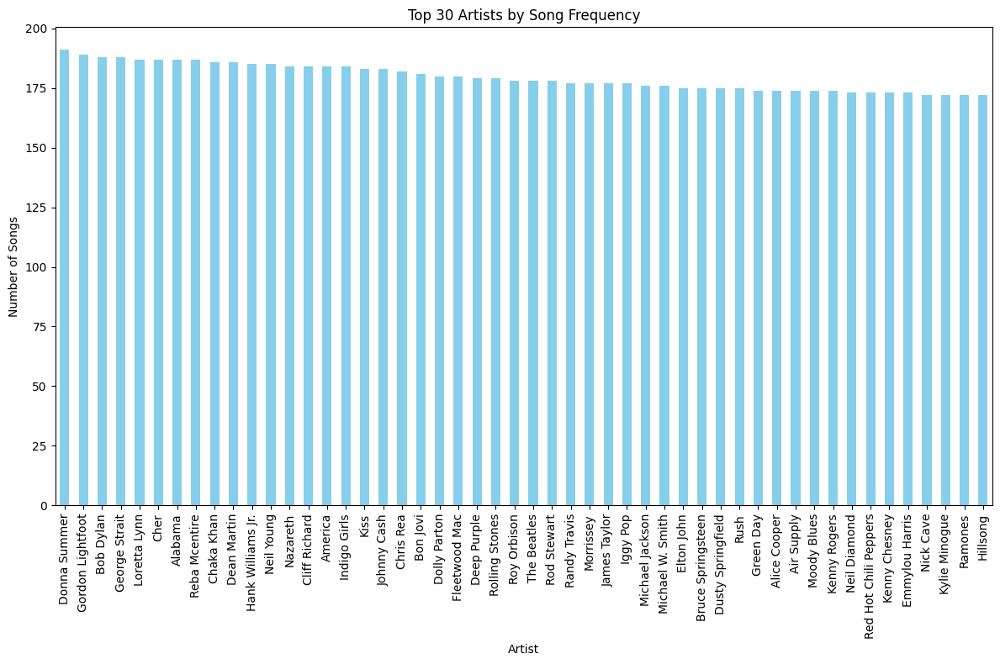

In [158]:
artist_song_freq = spotifyDFCopy['artist'].value_counts().nlargest(50)
plt.figure(figsize=(12, 8))
artist_song_freq.plot(kind='bar', color='skyblue')
plt.title('Top 30 Artists by Song Frequency')
plt.xlabel('Artist')
plt.ylabel('Number of Songs')
plt.xticks(rotation=90)
plt.tight_layout()
plt.show()

## Words in lyrics per song

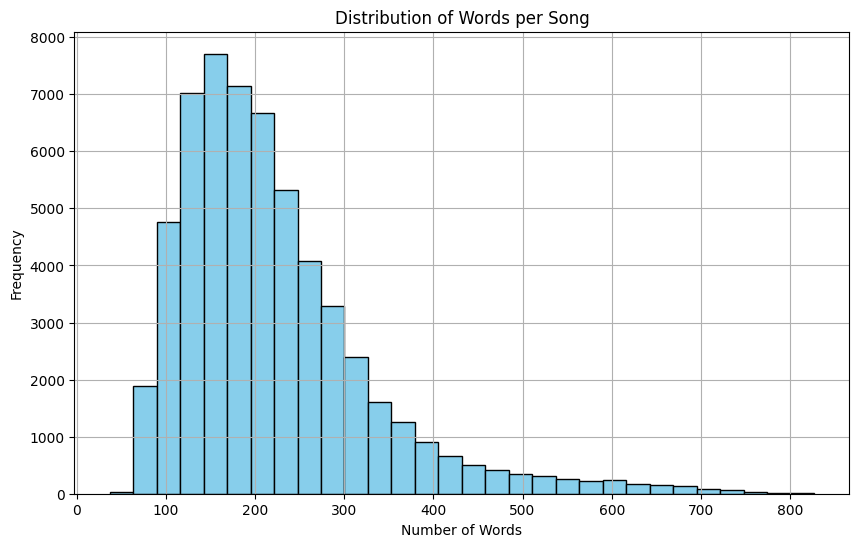

In [159]:
word_counts = []
for lyrics in spotifyDFCopy['text']:
    word_count = len(lyrics.split())
    word_counts.append(word_count)

plt.figure(figsize=(10, 6))
plt.hist(word_counts, bins=30, color='skyblue', edgecolor='black')
plt.title('Distribution of Words per Song')
plt.xlabel('Number of Words')
plt.ylabel('Frequency')
plt.grid(True)
plt.show()

## Repetition of words in a song

In [160]:
from collections import Counter

def calculate_repetition_scores(songs_lemmatized):
    repetition_scores = []
    for song_lyrics in songs_lemmatized:
        stem_counts = Counter(song_lyrics)
        unique_stems = len(stem_counts)
        total_stems = sum(stem_counts.values())
        repetition_score = unique_stems / total_stems if total_stems > 0 else 0
        repetition_scores.append(repetition_score)
    return repetition_scores


In [161]:
repetition_scores = calculate_repetition_scores(final_DF_after_cleaning)
print("Repetition Scores:", repetition_scores)


Repetition Scores: [0.6585365853658537, 0.3853211009174312, 0.39285714285714285, 0.5056179775280899, 0.5054945054945055, 0.851063829787234, 0.5844155844155844, 0.4774774774774775, 0.6, 0.3389830508474576, 0.4, 0.4946236559139785, 0.6964285714285714, 0.42452830188679247, 0.44680851063829785, 0.4175824175824176, 0.5921052631578947, 0.35, 0.6632653061224489, 0.42127659574468085, 0.8444444444444444, 0.5159574468085106, 0.37777777777777777, 0.41025641025641024, 0.33064516129032256, 0.8301886792452831, 0.6547619047619048, 0.48148148148148145, 0.4418604651162791, 0.43609022556390975, 0.5739130434782609, 0.3469387755102041, 0.384180790960452, 0.384, 0.43037974683544306, 0.43636363636363634, 0.4230769230769231, 0.36764705882352944, 0.6068965517241379, 0.4696969696969697, 0.6825396825396826, 0.6615384615384615, 0.30939226519337015, 0.4864864864864865, 0.6666666666666666, 0.32057416267942584, 0.8518518518518519, 0.5514018691588785, 0.3798449612403101, 0.4189189189189189, 0.675, 0.7692307692307693

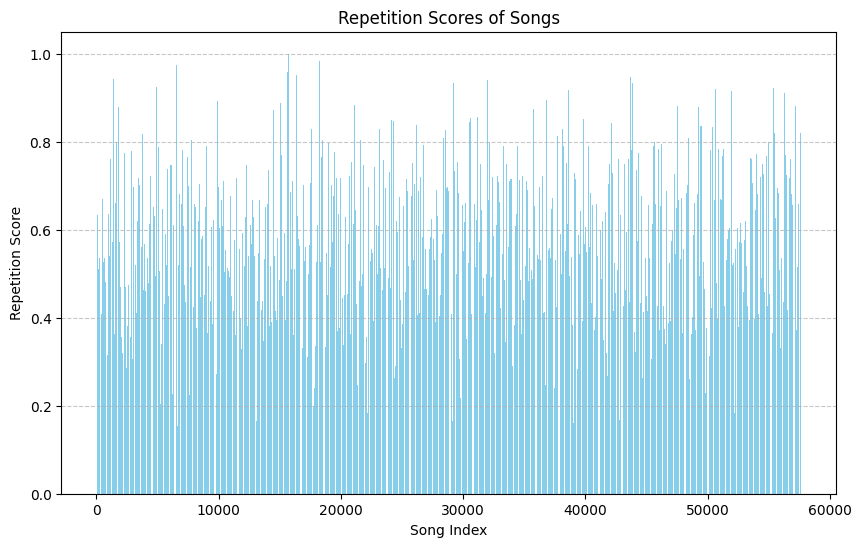

In [162]:
plt.figure(figsize=(10, 6))
plt.bar(range(1, len(repetition_scores) + 1), repetition_scores, color='skyblue')
plt.xlabel('Song Index')
plt.ylabel('Repetition Score')
plt.title('Repetition Scores of Songs')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()

## Top words in song lyrics

In [163]:
from wordcloud import WordCloud

lyrics = spotifyDFCopy['text'].str.cat(sep=' ')
words = lyrics.split()
word_freq = Counter(words)
top_words = word_freq.most_common(20)
wordcloud = WordCloud(width=800, height=400, background_color='white').generate_from_frequencies(word_freq)

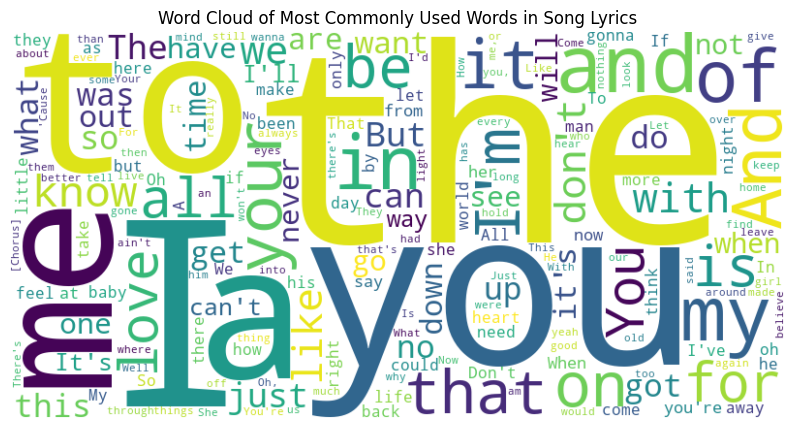

In [164]:
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Most Commonly Used Words in Song Lyrics')
plt.show()

In [165]:
filtered_words = [word.lower() for array in final_DF_after_cleaning for word in array]
word_freq = Counter(filtered_words)
wordcloud = WordCloud(width=800, height=400, background_color='white').generate_from_frequencies(word_freq)

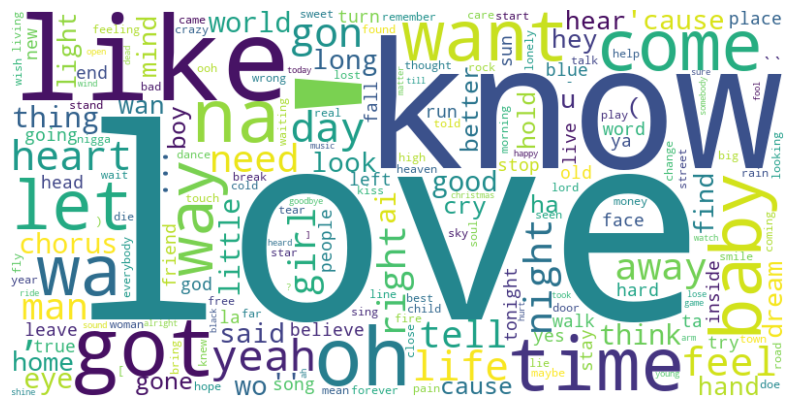

In [166]:
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.show()

# Milestone 2

In [167]:
import tensorflow as tf
import gensim
from gensim.models.doc2vec import Doc2Vec, TaggedDocument
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.datasets import imdb
from tensorflow.keras.preprocessing import sequence
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Embedding, SimpleRNN
from sklearn.model_selection import train_test_split
from tensorflow.keras.layers import Input
from tensorflow.keras.preprocessing.text import Tokenizer
from gensim.models import Word2Vec


## Preparing the Dataset 

After tokenizing, stemming, removing punctuations ,lines and stop words, we saved the pre-cleadned version of each song in a new column called 'text_cleaned'

In [168]:
spotifyDFCopy['text_cleaned']

0        [look, face, wonderful, face, mean, special, l...
1        [easy, touch, gently, like, summer, evening, b...
2        [know, lousy, rotten, boy, wa, tough, packing,...
3        [making, somebody, happy, question, learn, com...
4        [making, somebody, happy, question, learn, com...
                               ...                        
57645    [irie, day, come, play, let, angel, fly, let, ...
57646    [power, worker, power, power, worker, need, po...
57647    [need, believe, flashlight, hall, cause, day, ...
57648    [northern, star, frightened, rest, sleep, figh...
57649    [come, home, bit, late, hate, wait, heart, son...
Name: text_cleaned, Length: 57650, dtype: object

Now we need to clean that new column based on the data analysis that we did before.

Firstly, we need to remove any songs that have a repitition score above 0.7, since it would be useless to have a song made up of 2-3 words.

In [169]:
def filter_songs_by_repetition(df, threshold=0.7):
  df['repetition_score'] = calculate_repetition_scores(df['text_cleaned'])  
  filtered_df = df[df['repetition_score'] <= threshold]

  return filtered_df

In [170]:
spotifyDFCopy.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 57650 entries, 0 to 57649
Data columns (total 5 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   artist        57650 non-null  object
 1   song          57650 non-null  object
 2   link          57650 non-null  object
 3   text          57650 non-null  object
 4   text_cleaned  57650 non-null  object
dtypes: object(5)
memory usage: 2.2+ MB


In [171]:
spotifyDFCopy=filter_songs_by_repetition(spotifyDFCopy)

In [172]:
print(spotifyDFCopy.info())

<class 'pandas.core.frame.DataFrame'>
Index: 43565 entries, 0 to 57649
Data columns (total 6 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   artist            43565 non-null  object 
 1   song              43565 non-null  object 
 2   link              43565 non-null  object 
 3   text              43565 non-null  object 
 4   text_cleaned      43565 non-null  object 
 5   repetition_score  43565 non-null  float64
dtypes: float64(1), object(5)
memory usage: 2.3+ MB
None


In [173]:
SingleArtistDF=  spotifyDFCopy[spotifyDFCopy['artist'] == 'Donna Summer'].copy()

In [174]:
word_counts_SINGLE = [len(lyrics.split()) for lyrics in SingleArtistDF['text']]

In [175]:
def most_frequent_numbers(arr, k):
    counter = Counter(arr)
    most_common = counter.most_common(k)
    return [item[0] for item in most_common]

In [176]:
result = most_frequent_numbers(word_counts_SINGLE, 1)
maxWordsInSong=result[0]
print(maxWordsInSong)

224


In [177]:
SingleArtistDF

,artist,song,link,text,text_cleaned,repetition_score
4370,Donna Summer,A Runner With The Pack,/d/donna+summer/a+runner+with+the+pack_2004226...,He's got a second side he's got sixth sense \...,"[got, second, got, sixth, sense, got, got, got...",0.662791
4371,Donna Summer,All Through The Night,/d/donna+summer/all+through+the+night_20042205...,"You know, boy \r\nYou're so busy reaching for...","[know, boy, busy, reaching, dream, doe, exist,...",0.307692
4372,Donna Summer,Any Way At All,/d/donna+summer/any+way+at+all_20042359.html,Ooo \r\nHey baby \r\nOoo \r\n \r\nWe never...,"[ooo, hey, baby, ooo, know, wind, love, carry,...",0.474359
4373,Donna Summer,Autumn Changes,/d/donna+summer/autumn+changes_20042249.html,This love of ours \r\nIs gradually fading \r...,"[love, gradually, fading, wrong, somebody, fak...",0.342857
4374,Donna Summer,Back In Love Again,/d/donna+summer/back+in+love+again_20042253.html,Lately I'm feeling glad I'm alive \r\n'Cause ...,"[lately, feeling, glad, alive, 'cause, feel, g...",0.208333
...,...,...,...,...,...,...
30227,Donna Summer,To Turn The Stone,/d/donna+summer/to+turn+the+stone_20042275.html,The moon retreats behind a silver cloud \r\nA...,"[moon, retreat, silver, cloud, darkness, throw...",0.688889
30228,Donna Summer,True Love Survives,/d/donna+summer/true+love+survives_20042276.html,On big alley stands a lady waiting \r\nFor aw...,"[big, alley, stand, lady, waiting, awhile, act...",0.603604
30229,Donna Summer,"Try Me, I Know We Can Make It",/d/donna+summer/try+me+i+know+we+can+make+it_1...,"Try me, try me, try me, try me \r\nJust one t...","[try, try, try, try, time, try, try, try, try,...",0.204678
30230,Donna Summer,Unconditional Love,/d/donna+summer/unconditional+love_20042347.html,What a man \r\nYou know it's a bright and shi...,"[man, know, bright, shiny, day, want, love, li...",0.586667


## Word2Vec


In [178]:
SingleArtistDF['X'] = SingleArtistDF['text_cleaned'].apply(lambda x: x[:-1])  
SingleArtistDF['Y'] = SingleArtistDF['text_cleaned'].apply(lambda x: [x[-1]] if len(x) > 0 else None)

After Preparing the dataset and creating text_cleaned column Now we will use Word2Vec to create the enocoded version of that

In [449]:
word2vec_model = Word2Vec(
    sentences=SingleArtistDF['text_cleaned'],
    window=5,
    min_count=1,
    workers=4,
    sg=1,
    vector_size=10
)

In [491]:
word2vec_model.build_vocab(SingleArtistDF['text_cleaned'])
vocab_embeddings_dict = word2vec_model.wv

word_embeddings_dict = {}

for word in vocab_embeddings_dict.key_to_index.keys():
    word_embeddings_dict[word] = word2vec_model.wv[word]

print(word_embeddings_dict)

{'love': array([ 0.07115576, -0.24743539,  0.46128303,  0.11254668, -0.17980348,
        0.5373988 ,  0.5770483 , -0.03981249, -0.40631378,  0.2563679 ],
      dtype=float32), 'oh': array([ 0.33118463, -0.28740573,  0.6719335 ,  0.13488251, -0.02569191,
        0.83754617,  0.71079755,  0.07817775, -0.58118963,  0.32575282],
      dtype=float32), 'baby': array([ 0.06195248, -0.1328506 ,  0.37219748,  0.14124675, -0.23591736,
        0.52953345,  0.4965094 , -0.06260004, -0.4181594 ,  0.39679506],
      dtype=float32), 'got': array([ 0.54993564,  0.44397175,  2.0054321 ,  0.25894466,  0.3858557 ,
       -0.25255147,  2.4082856 ,  0.93308043, -1.7632079 ,  1.5471265 ],
      dtype=float32), 'know': array([ 1.032172  ,  0.00828763,  1.3365077 , -1.4032924 ,  0.06713016,
        1.4667356 ,  1.0248005 , -0.2864544 , -0.2809364 ,  0.37517804],
      dtype=float32), 'time': array([-0.11645086, -0.32561156,  0.4454207 ,  0.7039799 , -0.2405655 ,
        1.2045506 ,  0.7508468 ,  0.2575071 , -

In [492]:
lookup = tf.keras.layers.StringLookup(output_mode="one_hot", max_tokens=len(word_embeddings_dict))

In [493]:
labels_val = tf.ragged.constant(SingleArtistDF["Y"].values)

lookup.adapt(labels_val)
vocab = lookup.get_vocabulary()

print("Vocabulary:")
print(vocab)

Vocabulary:
['[UNK]', '...', 'love', 'chorus', 'tonight', 'time', 'heart', '.....', "''", 'away', '.', 'yeah', 'want', 'think', 'tear', 'right', 'oh', 'night', 'loved', 'leave', 'home', 'forever', 'fade', 'baby', 'ya', 'x3', 'worthless', 'woman', 'wind', 'waiting', 'unknown', 'try', 'trick', 'tokyo', 'till', 'summer', 'storm', 'stone', 'spotlight', 'soul', 'shall', 'science', 'sally', 'rumour', 'rose', 'ride', 'respect', 'reputation', 'reign', 'rebel', 'real', 'rainbow', 'radio', 'power', 'poor', 'place', 'pack', 'ooo', 'nightlife', 'need', 'mister', 'mad', 'little', 'listen', 'like', 'life', 'know', 'key', 'hurt', 'hold', 'higher', 'help', 'heaven', 'heard', 'happily', 'guess', 'ground', 'goodbye', 'girl', 'free', 'forgive', 'finally', 'fever', 'fast', 'dream', 'domino', 'distance', 'day', 'dark', 'dance', 'cry', 'cool', 'child', 'carry', 'came', 'bring', 'breakaway', 'born', 'beware', 'backwards', 'anymore', 'ah', 'affair', '....', '..', ',', ')', "'", '!']


In [494]:
lookup(vocab[2]).numpy()

array([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
      dtype=int64)

In [495]:
len(word_embeddings_dict)

2188

In [496]:
def encode_sequence(sequence, word_embeddings_dict):
    encoded_sequence = [word_embeddings_dict.get(word) for word in sequence if word in word_embeddings_dict]
    return encoded_sequence

SingleArtistDF['text_encoded'] = SingleArtistDF['text_cleaned'].apply(lambda x: encode_sequence(x, word_embeddings_dict))


In [497]:
SingleArtistDF['X']=SingleArtistDF['text_encoded']

In [498]:
dict={}
i=0
for word in word_embeddings_dict.keys():
    dict[i]=word_embeddings_dict[word]
    i=i+1

In [499]:
new_dict={}
index=0
for key in word_embeddings_dict.keys():
    new_dict[index]=key
    index+= 1

In [500]:
# def key(value): 
#     for key, val in word_embeddings_dict.items():
#         if val==value:
#             return key
#         return None

In [501]:
padded_sequences = pad_sequences(SingleArtistDF['X'], maxlen=maxWordsInSong, padding='post', truncating='post', dtype='float32')
SingleArtistDF['X_padded'] = [seq.tolist() for seq in padded_sequences]

In [502]:
SingleArtistDF

,artist,song,link,text,text_cleaned,repetition_score,X,Y,text_encoded,X_padded
4370,Donna Summer,A Runner With The Pack,/d/donna+summer/a+runner+with+the+pack_2004226...,He's got a second side he's got sixth sense \...,"[got, second, got, sixth, sense, got, got, got...",0.662791,"[[0.54993564, 0.44397175, 2.0054321, 0.2589446...",[pack],"[[0.54993564, 0.44397175, 2.0054321, 0.2589446...","[[0.5499356389045715, 0.44397175312042236, 2.0..."
4371,Donna Summer,All Through The Night,/d/donna+summer/all+through+the+night_20042205...,"You know, boy \r\nYou're so busy reaching for...","[know, boy, busy, reaching, dream, doe, exist,...",0.307692,"[[1.032172, 0.008287625, 1.3365077, -1.4032924...",[right],"[[1.032172, 0.008287625, 1.3365077, -1.4032924...","[[1.0321719646453857, 0.008287625387310982, 1...."
4372,Donna Summer,Any Way At All,/d/donna+summer/any+way+at+all_20042359.html,Ooo \r\nHey baby \r\nOoo \r\n \r\nWe never...,"[ooo, hey, baby, ooo, know, wind, love, carry,...",0.474359,"[[0.22407356, -0.11263703, 0.6560045, 0.422463...",[ooo],"[[0.22407356, -0.11263703, 0.6560045, 0.422463...","[[0.22407355904579163, -0.11263702809810638, 0..."
4373,Donna Summer,Autumn Changes,/d/donna+summer/autumn+changes_20042249.html,This love of ours \r\nIs gradually fading \r...,"[love, gradually, fading, wrong, somebody, fak...",0.342857,"[[0.071155764, -0.24743539, 0.46128303, 0.1125...",[oh],"[[0.071155764, -0.24743539, 0.46128303, 0.1125...","[[0.07115576416254044, -0.24743539094924927, 0..."
4374,Donna Summer,Back In Love Again,/d/donna+summer/back+in+love+again_20042253.html,Lately I'm feeling glad I'm alive \r\n'Cause ...,"[lately, feeling, glad, alive, 'cause, feel, g...",0.208333,"[[-0.030411612, -0.16607754, 0.45872733, 0.165...",[ya],"[[-0.030411612, -0.16607754, 0.45872733, 0.165...","[[-0.03041161224246025, -0.16607753932476044, ..."
...,...,...,...,...,...,...,...,...,...,...
30227,Donna Summer,To Turn The Stone,/d/donna+summer/to+turn+the+stone_20042275.html,The moon retreats behind a silver cloud \r\nA...,"[moon, retreat, silver, cloud, darkness, throw...",0.688889,"[[0.27751246, -0.3349651, 0.63128793, 0.202290...",[stone],"[[0.27751246, -0.3349651, 0.63128793, 0.202290...","[[0.27751246094703674, -0.3349651098251343, 0...."
30228,Donna Summer,True Love Survives,/d/donna+summer/true+love+survives_20042276.html,On big alley stands a lady waiting \r\nFor aw...,"[big, alley, stand, lady, waiting, awhile, act...",0.603604,"[[0.16159636, -0.21359667, 0.482398, 0.2462825...",[forever],"[[0.16159636, -0.21359667, 0.482398, 0.2462825...","[[0.1615963578224182, -0.2135966718196869, 0.4..."
30229,Donna Summer,"Try Me, I Know We Can Make It",/d/donna+summer/try+me+i+know+we+can+make+it_1...,"Try me, try me, try me, try me \r\nJust one t...","[try, try, try, try, time, try, try, try, try,...",0.204678,"[[0.22743776, -0.11560365, 0.481143, 0.0817417...",[...],"[[0.22743776, -0.11560365, 0.481143, 0.0817417...","[[0.22743776440620422, -0.11560364812612534, 0..."
30230,Donna Summer,Unconditional Love,/d/donna+summer/unconditional+love_20042347.html,What a man \r\nYou know it's a bright and shi...,"[man, know, bright, shiny, day, want, love, li...",0.586667,"[[0.2421022, 0.014695718, 0.72736233, 0.301589...",[x3],"[[0.2421022, 0.014695718, 0.72736233, 0.301589...","[[0.24210220575332642, 0.014695717953145504, 0..."


In [503]:
train_df, test_df = train_test_split(SingleArtistDF, test_size=0.2, random_state=42) 
print("Training Set Shape:", train_df.shape)
print("Testing Set Shape:", test_df.shape)

Training Set Shape: (138, 10)
Testing Set Shape: (35, 10)


## Create the model

In [533]:
def create_lyric_generator(gru_units):
  model = tf.keras.Sequential([
    tf.keras.layers.GRU(gru_units, return_sequences=True),
    tf.keras.layers.GRU(gru_units, return_sequences=False),
    tf.keras.layers.Dense(64, activation='relu'),
    tf.keras.layers.Dense(len(lookup.get_vocabulary()), activation='softmax')
  ])
  return model


In [534]:
model = create_lyric_generator(gru_units=128)

In [535]:
model.compile(optimizer='adam',
              loss='binary_crossentropy',  
              metrics=['accuracy'])


In [536]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 138 entries, 30211 to 30156
Data columns (total 10 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   artist            138 non-null    object 
 1   song              138 non-null    object 
 2   link              138 non-null    object 
 3   text              138 non-null    object 
 4   text_cleaned      138 non-null    object 
 5   repetition_score  138 non-null    float64
 6   X                 138 non-null    object 
 7   Y                 138 non-null    object 
 8   text_encoded      138 non-null    object 
 9   X_padded          138 non-null    object 
dtypes: float64(1), object(9)
memory usage: 11.9+ KB


In [537]:
X_train = [np.asarray(x) for x in train_df['X_padded']] 
Y_train = [lookup(x[0]).numpy() for x in train_df['Y']]

In [538]:
X_train = tf.stack(X_train)
Y_train= tf.stack(Y_train)

In [539]:
history = model.fit(X_train, Y_train, epochs=15, batch_size=32, verbose=1)

Epoch 1/10
5/5 ━━━━━━━━━━━━━━━━━━━━ 8s 231ms/step - accuracy: 0.0081 - loss: 0.6919
Epoch 2/10
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 237ms/step - accuracy: 0.0081 - loss: 0.6795
Epoch 3/10
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 220ms/step - accuracy: 0.0081 - loss: 0.6193
Epoch 4/10
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 227ms/step - accuracy: 0.0024 - loss: 0.3808  
Epoch 5/10
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 249ms/step - accuracy: 0.0081 - loss: 0.2297
Epoch 6/10
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 247ms/step - accuracy: 0.0081 - loss: 0.1372
Epoch 7/10
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 222ms/step - accuracy: 0.0000e+00 - loss: 0.0884
Epoch 8/10
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 238ms/step - accuracy: 0.0000e+00 - loss: 0.0649
Epoch 9/10
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 219ms/step - accuracy: 0.0024 - loss: 0.0562  
Epoch 10/10
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 230ms/step - accuracy: 0.1243 - loss: 0.0520


In [540]:
model.summary()

Model: "sequential_8"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_16 (GRU)                    │ (None, 224, 128)       │        53,760 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_17 (GRU)                    │ (None, 128)            │        99,072 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_16 (Dense)                │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_17 (Dense)                │ (None, 109)            │         7,085 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 504,521 (1.92 MB)

 Trainable params: 168,173 (656.93 KB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 336,348 (1.28 MB)

In [571]:
test_df.head(10)

,artist,song,link,text,text_cleaned,repetition_score,X,Y,text_encoded,X_padded
30220,Donna Summer,The Power Of One,/d/donna+summer/the+power+of+one_20300219.html,You must always remember \r\nLife can be a ch...,"[remember, life, challenge, life, impossible, ...",0.444444,"[[0.29154646, -0.042034797, 0.2868188, 0.34741...",[power],"[[0.29154646, -0.042034797, 0.2868188, 0.34741...","[[0.29154646396636963, -0.04203479737043381, 0..."
4417,Donna Summer,Mystery Of Love,/d/donna+summer/mystery+of+love_20042245.html,Seasons are changing \r\nChildren of love are...,"[seasons, changing, children, love, alive, peo...",0.479592,"[[0.118673176, -0.8093226, 1.2816228, 0.022461...",[key],"[[0.118673176, -0.8093226, 1.2816228, 0.022461...","[[0.118673175573349, -0.8093225955963135, 1.28..."
30144,Donna Summer,Hot Stuff,/d/donna+summer/hot+stuff_20042209.html,Sittin' here eatin' my heart out waitin' \r\n...,"[sittin, ', eatin, ', heart, waitin, ', waitin...",0.223602,"[[0.12776607, -0.03456267, 0.08220936, -0.0051...",[tonight],"[[0.12776607, -0.03456267, 0.08220936, -0.0051...","[[0.12776607275009155, -0.034562669694423676, ..."
4437,Donna Summer,Tokyo,/d/donna+summer/tokyo_20042346.html,"Met this stranger there, so I was \r\nFeeling...","[met, stranger, wa, feeling, somewhat, scared,...",0.491228,"[[0.19175038, -0.15487352, 0.29020745, 0.06658...",[tokyo],"[[0.19175038, -0.15487352, 0.29020745, 0.06658...","[[0.19175037741661072, -0.15487352013587952, 0..."
30168,Donna Summer,Little Miss Fit,/d/donna+summer/little+miss+fit_20042284.html,There's a good there's a bad \r\nSome are gay...,"[good, bad, gay, sad, right, wrong, fit, belon...",0.474359,"[[0.3326778, -0.2161824, 0.44674137, -0.626916...",[poor],"[[0.3326778, -0.2161824, 0.44674137, -0.626916...","[[0.33267781138420105, -0.2161823958158493, 0...."
30192,Donna Summer,Queen For A Day,/d/donna+summer/queen+for+a+day_20042335.html,"Queen for a day, queen for a night \r\nDresse...","[queen, day, queen, night, dressed, head, toe,...",0.247706,"[[0.22296146, -0.2524192, 0.34514844, 0.208910...",[day],"[[0.22296146, -0.2524192, 0.34514844, 0.208910...","[[0.2229614555835724, -0.25241920351982117, 0...."
4416,Donna Summer,My Man Medley,/d/donna+summer/my+man+medley_20042300.html,Spoken: \r\nI just wanna say this \r\nThis i...,"[spoken, wan, na, thing, lady, identify, maybe...",0.500000,"[[0.2059818, -0.076206274, 0.5332686, 0.004615...",[...],"[[0.2059818, -0.076206274, 0.5332686, 0.004615...","[[0.2059818059206009, -0.076206274330616, 0.53..."
4388,Donna Summer,Drivin' Down Brazil,/d/donna+summer/drivin+down+brazil_20832590.html,Tudo bem... Tudo bem... Tudo bom bom... \r\nT...,"[tudo, bem, ..., tudo, bem, ..., tudo, bom, bo...",0.237113,"[[0.05629154, -0.14966665, 0.39371985, 0.19076...",[waiting],"[[0.05629154, -0.14966665, 0.39371985, 0.19076...","[[0.05629153922200203, -0.1496666520833969, 0...."
30167,Donna Summer,Let's Work Together Now,/d/donna+summer/lets+work+together+now_2004228...,Different faces other races \r\nNew condition...,"[different, face, race, new, condition, old, t...",0.406250,"[[0.0020890054, -0.018089954, 0.2868984, 0.169...",[child],"[[0.0020890054, -0.018089954, 0.2868984, 0.169...","[[0.0020890054292976856, -0.018089953809976578..."
30162,Donna Summer,Lady Of The Night,/d/donna+summer/lady+of+the+night_20042282.html,They call her the lady of the night \r\nShe's...,"[lady, night, woman, world, easy-living, girl,...",0.500000,"[[-0.0045261225, -0.00040449397, 0.17800513, 0...",[came],"[[-0.0045261225, -0.00040449397, 0.17800513, 0...","[[-0.004526122473180294, -0.000404493970563635..."


In [580]:
# def generate_song(seed_sequence, max_length=10):zz
#   sequence = [word_embeddings_dict[word] for word in seed_sequence]
#   sequence = pad_sequences([sequence], maxlen=max_length, padding="post")
#   generated_song = " ".join(seed_sequence)
#   for _ in range(max_length - len(seed_sequence)):
#     predictions = model.predict(sequence)
#     next_word_index = tf.math.argmax(predictions[0]).numpy()
#     next_word = word2vec_model.wv.index_to_key[next_word_index]
#     # sequence = np.append(sequence[:, 1:], [[next_word_index]], axis=1)
#     generated_song += " " + next_word
#   return generated_song
def generate_song(seed_sequence, max_length=10):
  i = 0
  while i < len(seed_sequence):
    k = 0
    seed= seed_sequence[i]
    sequence = [word_embeddings_dict[word] for word in seed_sequence[i] if word in word_embeddings_dict]
    sequence = pad_sequences([sequence], maxlen=max_length, padding="post")
    generated_song = " ".join(seed)
    for k in range(max_length):
      if k==0 :
        predictions = model.predict(sequence)
        next_word_index = tf.math.argmax(predictions[0]).numpy()
        next_word =new_dict.get(next_word_index)
        generated_song += " " + next_word
        seed+=next_word
        k=k+1
      else:
        sequence = [word_embeddings_dict[word] for word in seed_sequence[i] if word in word_embeddings_dict]
        sequence = pad_sequences([sequence], maxlen=max_length, padding="post")
        predictions = model.predict(sequence)
        next_word_index = tf.math.argmax(predictions[0]).numpy()
        next_word = new_dict.get(next_word_index)
        generated_song += " " + next_word
        seed+=next_word
        k=k+1
    i=i+1  
        
        
  return generated_song

seed_sequence1 = [['queen', 'day', 'queen', 'night', 'dressed', 'head', 'toe']]
# print(test_df["text_cleaned"][30192])
# seed_sequence=[test_df["text_cleaned"][30192]]
# ,SingleArtistDF["text_cleaned"][4374]

print(seed_sequence1)
generated_song = generate_song(seed_sequence1)
print(generated_song)


[['queen', 'day', 'queen', 'night', 'dressed', 'head', 'toe']]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
queen day queen night dressed head toe oh oh oh oh oh oh oh oh oh oh


# Milestone 3

In [549]:
# def most_frequent_numbers(arr, k):
#     counter = Counter(arr)
#     most_common = counter.most_common(k)
#     return [item[0] for item in most_common]
# result = most_frequent_numbers(word_counts, 1)
# maxWordsInSong=result[0]
# print(maxWordsInSong)

First we Want to shuffle the dataset

The train_test_split function from scikit-learn shuffles the dataset before splitting it into training and testing sets, thus there's no need to shuffle the whole dataset before splitting, or the seperate train/test datasets after splitting.

In [550]:
# shuffled_df = spotifyDFCopy.sample(frac=1).reset_index(drop=True)

Now we want to vectorize,encode the artist name to concatenate it later with the lyrics encoding

In [551]:
# from sklearn.preprocessing import OneHotEncoder
# artist_names=SingleArtistDF['artist'].tolist()
# def one_hot_encode_strings(strings):
#     encoder = OneHotEncoder(sparse=False)
#     strings_2d = np.array(strings).reshape(-1, 1)
#     encoded_strings = encoder.fit_transform(strings_2d)
#     return encoded_strings
# encoded_vectors = one_hot_encode_strings(artist_names)
# list_of_arrays = [arr for arr in encoded_vectors]
# SingleArtistDF['artist_oneHot']=list_of_arrays

In [552]:
# type(SingleArtistDF['artist_oneHot'][1][0])

In [553]:
# merged_column = train_df.apply(lambda row: np.concatenate([row['text_encoded_padded'], row['artist_oneHot']]).astype(float), axis=1)
# train_df['merged'] = merged_column
# merged_column_tensor = tf.constant(merged_column.tolist())
# merged_column_tensor.shape
# Artist_tensor = tf.constant(train_df['artist_oneHot'].tolist())
# lyrics_tensor = tf.constant(train_df['text_encoded_padded'].tolist())


In [554]:
# SingleArtistDF.drop(columns=['song'], inplace=True)
# SingleArtistDF.drop(columns=['artist'], inplace=True)
# SingleArtistDF.drop(columns=['text'], inplace=True)
# SingleArtistDF.drop(columns=['link'], inplace=True)	
# SingleArtistDF.drop(columns=['repetition_score'], inplace=True)

In [555]:
# def create_unique_artists(artist_data):
#   """
#   Creates a list of unique artists from the provided artist data.

#   Args:
#       artist_data: A list containing artist names associated with each lyric sequence (strings).

#   Returns:
#       A list of unique artist names (strings).
#   """
#   all_artists = []
#   for artist_name in artist_data:
#     all_artists.append(artist_name)
#   unique_artists = list(set(all_artists))  # Remove duplicates using set
#   return unique_artists

In [556]:
# # Create an empty dictionary to store artist encodings
# artist_encodings = {}

# # Get the unique artists list
# unique_artists = SingleArtistDF['artist'].unique().tolist()

# # Function to encode an artist (already defined)
# def one_hot_encode_artist(artist_name, num_artists):
#     artist_index = unique_artists.index(artist_name)  # Find artist index
#     one_hot_vector = np.zeros(num_artists)
#     one_hot_vector[artist_index] = 1
#     return one_hot_vector

# # Loop through each unique artist
# for artist_name in unique_artists:
#   # Get the number of unique artists
#   num_artists = len(unique_artists)
#   # Encode the artist name
#   encoded_artist_vector = one_hot_encode_artist(artist_name, num_artists)
#   # Add the encoding to the dictionary (artist name as key)
#   artist_encodings[artist_name] = encoded_artist_vector


In [557]:
# artist_encodings

In [558]:
# # Define a lambda function to map artist names to encoded vectors
# def artist_to_encoding(artist_name):
#   # Check if the artist exists in the dictionary
#   if artist_name in artist_encodings:
#     return artist_encodings[artist_name]
#   else:
#     # Handle cases where the artist is not found (optional: return a default value or raise an error)
#     return np.zeros(len(unique_artists))  # Example: return a zero vector

# # Apply the lambda function to create the new column
# SingleArtistDF['artist_encoding'] = SingleArtistDF['artist'].apply(artist_to_encoding)


In [559]:
# artist_song_counts = spotifyDFCopy.groupby('artist')['artist'].size()
# top_10_artists = artist_song_counts.sort_values(ascending=False).head(20).index.tolist()
# SingleArtistDF = spotifyDFCopy[spotifyDFCopy['artist'].isin(top_10_artists)]

In [560]:
# tokenizer = Tokenizer(num_words=None,#By default the value of num_words is none  best value is the vocab_size
#                       filters='!"$%&()*,-./:;<=>?@[\\]^_`{|}~\t\n', #filter the text from punctuation we kept # and + for C# and C++
#                       lower=True,
#                       split=" ",#if you split with , or something else then this will be your splitter
#                       char_level=False, #tokenization as char level or word level
#                       oov_token=None) #what to replace an oov word with during training validation or testing


In [ ]:
# test_seq=pad_sequences(test_df['X_padded'], maxlen=maxWordsInSong, padding='post', truncating='post', dtype='float32')

In [ ]:
# predictions=model.predict(test_seq)

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 606ms/step


In [ ]:
# len(lookup.get_vocabulary())    

109

In [ ]:
# max_index = np.array(predictions[0]).argmax()
# max_index

1

In [ ]:
# lookup.get_vocabulary()[max_index]

'...'

In [ ]:
# SingleArtistDF

,artist,song,link,text,text_cleaned,repetition_score,X,Y,text_encoded,X_padded
4370,Donna Summer,A Runner With The Pack,/d/donna+summer/a+runner+with+the+pack_2004226...,He's got a second side he's got sixth sense \...,"[got, second, got, sixth, sense, got, got, got...",0.662791,"[[0.54993564, 0.44397175, 2.0054321, 0.2589446...",[pack],"[[0.54993564, 0.44397175, 2.0054321, 0.2589446...","[[0.5499356389045715, 0.44397175312042236, 2.0..."
4371,Donna Summer,All Through The Night,/d/donna+summer/all+through+the+night_20042205...,"You know, boy \r\nYou're so busy reaching for...","[know, boy, busy, reaching, dream, doe, exist,...",0.307692,"[[1.032172, 0.008287625, 1.3365077, -1.4032924...",[right],"[[1.032172, 0.008287625, 1.3365077, -1.4032924...","[[1.0321719646453857, 0.008287625387310982, 1...."
4372,Donna Summer,Any Way At All,/d/donna+summer/any+way+at+all_20042359.html,Ooo \r\nHey baby \r\nOoo \r\n \r\nWe never...,"[ooo, hey, baby, ooo, know, wind, love, carry,...",0.474359,"[[0.22407356, -0.11263703, 0.6560045, 0.422463...",[ooo],"[[0.22407356, -0.11263703, 0.6560045, 0.422463...","[[0.22407355904579163, -0.11263702809810638, 0..."
4373,Donna Summer,Autumn Changes,/d/donna+summer/autumn+changes_20042249.html,This love of ours \r\nIs gradually fading \r...,"[love, gradually, fading, wrong, somebody, fak...",0.342857,"[[0.071155764, -0.24743539, 0.46128303, 0.1125...",[oh],"[[0.071155764, -0.24743539, 0.46128303, 0.1125...","[[0.07115576416254044, -0.24743539094924927, 0..."
4374,Donna Summer,Back In Love Again,/d/donna+summer/back+in+love+again_20042253.html,Lately I'm feeling glad I'm alive \r\n'Cause ...,"[lately, feeling, glad, alive, 'cause, feel, g...",0.208333,"[[-0.030411612, -0.16607754, 0.45872733, 0.165...",[ya],"[[-0.030411612, -0.16607754, 0.45872733, 0.165...","[[-0.03041161224246025, -0.16607753932476044, ..."
...,...,...,...,...,...,...,...,...,...,...
30227,Donna Summer,To Turn The Stone,/d/donna+summer/to+turn+the+stone_20042275.html,The moon retreats behind a silver cloud \r\nA...,"[moon, retreat, silver, cloud, darkness, throw...",0.688889,"[[0.27751246, -0.3349651, 0.63128793, 0.202290...",[stone],"[[0.27751246, -0.3349651, 0.63128793, 0.202290...","[[0.27751246094703674, -0.3349651098251343, 0...."
30228,Donna Summer,True Love Survives,/d/donna+summer/true+love+survives_20042276.html,On big alley stands a lady waiting \r\nFor aw...,"[big, alley, stand, lady, waiting, awhile, act...",0.603604,"[[0.16159636, -0.21359667, 0.482398, 0.2462825...",[forever],"[[0.16159636, -0.21359667, 0.482398, 0.2462825...","[[0.1615963578224182, -0.2135966718196869, 0.4..."
30229,Donna Summer,"Try Me, I Know We Can Make It",/d/donna+summer/try+me+i+know+we+can+make+it_1...,"Try me, try me, try me, try me \r\nJust one t...","[try, try, try, try, time, try, try, try, try,...",0.204678,"[[0.22743776, -0.11560365, 0.481143, 0.0817417...",[...],"[[0.22743776, -0.11560365, 0.481143, 0.0817417...","[[0.22743776440620422, -0.11560364812612534, 0..."
30230,Donna Summer,Unconditional Love,/d/donna+summer/unconditional+love_20042347.html,What a man \r\nYou know it's a bright and shi...,"[man, know, bright, shiny, day, want, love, li...",0.586667,"[[0.2421022, 0.014695718, 0.72736233, 0.301589...",[x3],"[[0.2421022, 0.014695718, 0.72736233, 0.301589...","[[0.24210220575332642, 0.014695717953145504, 0..."
